# **AP155 Lab Assignment**
## Module 5: Partial Differential Equations

_Instructions_: Answer each problem as completely as you can. Discuss **all** your answers as clearly and concisely as possible.

_Scoring Criteria_: 50% - *correctness of code*; 50% - *discussion of the code and results*. Maximum score is **100 points**.



### Student Information

_Full Name (Last Name, First Name)_: Noche, Filomeno III \
_Student No._: 2019-07659\
_Section_: THV-TX-1

### Submission Information

_Date and Time Submitted (most recent upload)_:

**HONOR PLEDGE** I affirm that I have upheld the highest principles of honesty and integrity in my academic work and that this lab assignment is my own work.

**Sign here with your full name: Filomeno A. Noche III**

### Grading Information (c/o Lab Instructor)

TOTAL SCORE: **[]**/100

Score breakdown:
* Problem 1 - []/100

_Date and Time Scored (MM/DD/YYYY HH:MM AM/PM):_

### PROBLEM 1
**The Schrodinger equation and the Crank-Nicolson method**

_Refer to Exercise 9.8 in the Newman text._ In this problem, you will use the Crank-Nicolson method to solve the full time-dependent Schrodinger equation and hence develop a picture of how a wavefunction evolves over time.

Consider an electron (mass $M = 9.109 \times 10^{-31}$ kg) in a box of length $L = 10^{-8}$ m. Suppose that at time $t = 0$ the wavefunction of the electron has the form

$$ \psi(x,0) = \exp\left[-\frac{(x-x_0)^2}{2\sigma^2}\right]e^{i\kappa x},$$
where $x_0 = \frac{L}{2}$, $\sigma = 1 \times 10^{-10}$ m, $\kappa = 5 \times 10^{10} {\rm m}^{-1}$,  and $\psi = 0$ on the walls at $x = 0$ and $x = L$.

1. Perform a single step of the Crank-Nicolson method for this electron, calculating the vector $\psi(t)$ of values of the wavefunction, given the initial wavefunction above and using $N = 1000$ spatial slices with $a = L/N$. Your program will have to perform the following steps. First, given the vector $\psi(0)$ at $t = 0$, you will have to multiply by the matrix $\bf{B}$ to get a vector $\bf{v} = \bf{B}\psi$. Because of the tridiagonal form of $\bf{B}$, this is fairly simple. The $i$th component of $\bf{v}$ is given by
$$ v_i = b_1\psi_i + b_2(\psi_{i+1} + \psi_{i-1}).$$

   You will also have to choose a value for the time-step $h$. A reasonable choice is $h = 10^{-18}$ s. *(30 pts.)*

2. Second you will have to solve the linear system ${\bf Ax}= {\bf v}$ for $\bf{x}$, which gives you the new value of $\psi$. You could do this using a standard linear equation solver like the function $\tt solve$ in numpy's $\tt linalg$. *(20 pts.)*

3. Once you have the code in place to perform a single step of the calculation, extend your program to perform repeated steps and hence solve for $\psi$ at a sequence of times a separation $h$ apart. Note that the matrix $\bf A$ is independent of time, so it doesn't change from one step to another. You can set up the matrix just once and then keep on reusing it for every step. *(30 pts.)*

4. Make an animation of the solution by displaying the real part of the wavefunction at each time-step. You can use the function rate from the package visual to ensure a smooth frame-rate for your animation-- see Section 3.5 on page 117 of the Newman text.

   Run your animation for a while and describe what you see. Write a few sentences explaining in physics terms what is going on in the system. *(20 pts.)*

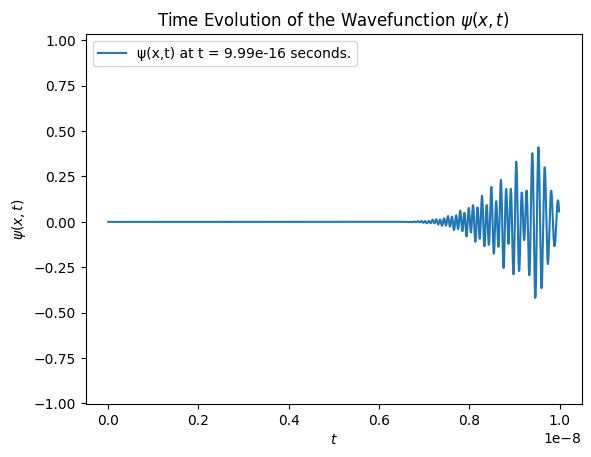

In [9]:

from numpy import zeros, linalg, arange, matmul, exp, pi
from pylab import plot, subplots, xlabel, ylabel, title, show, identity, eye, legend

from matplotlib.animation import FuncAnimation # For animation
from matplotlib import rc, legend, style # For the Media Contol Buttons for playback

#GIVEN and EQUATIONS
m=9.109e-31 #electron mass
l=1e-8 #length of box
x0=l/2 #initial position
sig=1e-10 #sigma
k=5e10 #kappa
h=1e-18 #reasonable time-step value
n=1000 #number of spatial slices
a=l/n #grid spacing
ħ=6.62607015e-34/(2*pi) #reduced Planck's constant
xarray=arange(0,l,a) #serves as the grid spacing along the box's length
ew=h*(1j*ħ)/(2*m*a*a)
a1, a2, b1, b2 = 1 + ew, -ew/2, 1 - ew, ew/2
A=a1*identity(n) + a2*eye(n,n,-1) + a2*eye(n,n,1) #tridiagonal matrix A
ψ=exp(-((xarray - x0)**2/(2*sig**2)))*exp(1j*k*xarray) #wave function

#REPEATED STEP ALGORITHM
def ψanim(frame): #function of the wavefunction for each frame
  global ψ #this recalls the wave function but the variable can be used inside and outside the function (global)
  v=zeros(n,dtype='complex') #vector initially set as an array of n zeros.
  v[1:-1] = b1*ψ[1:-1] + b2*(ψ[2:] + ψ[:-2]) #formula v=Bψ
  #first and last points is ψ=0 at boundary conditions x=0 and x=L
  ψ=linalg.solve(A,v) #solving x in Ax=v
  line.set_ydata(ψ.real) #used to update the data for the graph
  line.set_label(f'ψ(x,t) at t = {round(frame*h,18)} seconds.') # shows time as wavefunction updates per frame
  ax.legend(loc='upper left') #fixes time per frame legend to the upper left.
  return line, #returns line as it is being updated

rc('animation', html='jshtml') # this is for the playback buttons
fig,ax = subplots()
line, = ax.plot(xarray,ψ.real)
ax.set_title('Time Evolution of the Wavefunction $ψ(x,t)$')
ax.set_xlabel(r'$t$')
ax.set_ylabel(r'$ψ(x,t)$')
anim = FuncAnimation(fig,ψanim,frames=1000, blit=True,interval=10)
#FuncAnimation generates data for first frame and then modify this data for each frame to create an animated plot.
#fig: figure to be updated, ψanim: update function, frames: number of times update function is ran, blit: whether or not only the changed parts be redrawn for optimization, interval: milliseconds before the next frame
anim


Animated graph shows the time evolution of the given wavefunction. The Gaussian wave packet has an initial momentum $p=ħκ$ which causes it to move from its initial position $x_0 = \frac{L}{2}$. \
Due to the Uncertainty Principle $ΔxΔp≥\frac{ħ}{2}$, the initially low position uncertainty $Δx$ leads to a higher momentum uncertainty $Δp$ which causes the wave packet to "spread" more, that is, redistributing its total probability density broadly. This also consequently decreases the peak amplitude. And over time, as $Δx$ increases, $Δp$ decreases and it "spreads" less. \
As the wave hits the boundary at $x=L$, it is reflected back to the 'box' as the reflected wave which interferes with the incident wave, creating complex patterns in the amplitude and phase in the wavefunction. \